In [62]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix,classification_report
from wordcloud import WordCloud, STOPWORDS

#### No resumir outputs

In [63]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# LEER EL DATAFRAME

In [ ]:
url = 'https://media.githubusercontent.com/media/drakenlander/RevCsv/refs/heads/main/Reviews.csv'
df = pd.read_csv(url)

In [67]:
print(df.head())

   Id   ProductId          UserId                      ProfileName  \
0   1  B001E4KFG0  A3SGXH7AUHU8GW                       delmartian   
1   2  B00813GRG4  A1D87F6ZCVE5NK                           dll pa   
2   3  B000LQOCH0   ABXLMWJIXXAIN  Natalia Corres "Natalia Corres"   
3   4  B000UA0QIQ  A395BORC6FGVXV                             Karl   
4   5  B006K2ZZ7K  A1UQRSCLF8GW1T    Michael D. Bigham "M. Wassir"   

   HelpfulnessNumerator  HelpfulnessDenominator  Score        Time  \
0                     1                       1      5  1303862400   
1                     0                       0      1  1346976000   
2                     1                       1      4  1219017600   
3                     3                       3      2  1307923200   
4                     0                       0      5  1350777600   

                 Summary                                               Text  
0  Good Quality Dog Food  I have bought several of the Vitality canned d...  
1 

# ANÁLISIS DE DATOS
## Gráfico Inicial de Calificaciones

In [68]:
fig = px.bar(df['Score'].value_counts())
fig.show()

### Se Añaden Stopwords a la Lista Predeterminada

In [69]:
stop_words = STOPWORDS.update([
    'product',
    'really',
    'try',
    'tried',
    'buy',
    'bought',
    'buying',
    'purchased',
    'make',
    'made',
    'use',
    'using',
    'got',
    'say',
    'think',
    'thought',
    'thinking'
    'know',
    'find',
    'found',
    'look',
    'looking',
    'order',
    'ordered',
    'stuff',
    'thing',
    'item',
    'one',
    'much',
    'sure',
    'th',
    'b',
    'h'
    'm',
    'o',
    'w'
    ])


## Nube de Palabras de las Críticas

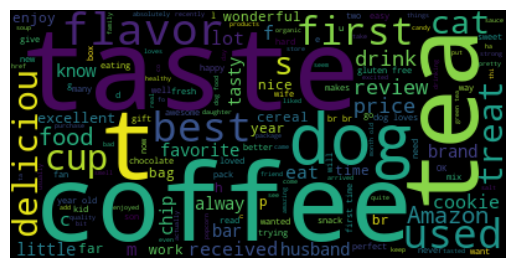

In [70]:
wordcloud = WordCloud(stopwords = stop_words).generate(df['Text'].to_string())

plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show(wordcloud)

# CLASIFICANDO LAS CRÍTICAS
### Generar Nueva Columna de Percepción General

In [71]:
conditions = [
    (df['Score'] < 3),
    (df['Score'] == 3),
    (df['Score'] > 3)
    ]

values = ['-1', '0', '+1']

In [72]:
df['Sentiment'] = np.select(conditions, values, default=pd.NaT)

# MÁS ANÁLISIS DE DATOS
#### Inicializar DFs para nubes de palabras

In [73]:
df_pos = df.loc[df['Sentiment'] == '+1']
df_neg = df.loc[df['Sentiment'] == '-1']

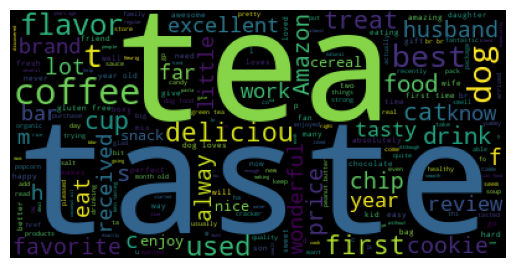

In [74]:
wordcloud_pos = WordCloud(stopwords = stop_words).generate(df_pos['Text'].to_string())

plt.imshow(wordcloud_pos)
plt.axis("off")
plt.show(wordcloud_pos)

## Nube de Palabras de las Críticas Negativas
#### Se añaden ciertas palabras cuya connotación puede malinterpretarse

In [75]:
neg_stop_words = STOPWORDS.update([
    'love',
    'great',
    'good',
    ])

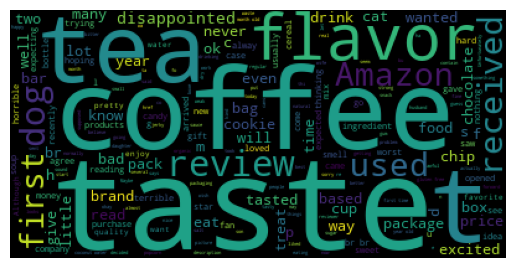

In [76]:
wordcloud_neg = WordCloud(stopwords = stop_words).generate(df_neg['Text'].to_string())

plt.imshow(wordcloud_neg)
plt.axis("off")
plt.show(wordcloud_neg)

## Graficar Percepción General

In [77]:
labels = ['Positive', 'Negative', 'Neutral']

fig = px.bar(df['Sentiment'].value_counts())
fig.update_xaxes(tickvals = ['+1', '-1', '0'], ticktext = labels)
fig.show()

# CONSTRUIR EL MODELO
## Limpieza de Datos
#### Es necesario eliminar los valores faltantes de la columna 'Summary' para iterar sobre ella

In [78]:
punctuation = [
    '.',
    ',',
    ':',
    ';',
    '!',
    '¡',
    '?',
    '¿',
    '\'',
    '\"'
]

def remove_punctuation(str):
    new_str = ''.join(x for x in str if x not in punctuation)
    return new_str

df = df.dropna(subset=['Summary'])
df['Summary'] = df['Summary'].apply(remove_punctuation)

In [79]:
print(df['Summary'])

0                                     Good Quality Dog Food
1                                         Not as Advertised
2                                       Delight says it all
3                                            Cough Medicine
4                                               Great taffy
5                                                Nice Taffy
6               Great  Just as good as the expensive brands
7                                     Wonderful tasty taffy
8                                                Yay Barley
9                                          Healthy Dog Food
10                          The Best Hot Sauce in the World
11        My cats LOVE this diet food better than their ...
12                     My Cats Are Not Fans of the New Food
13                                         fresh and greasy
14                             Strawberry Twizzlers - Yummy
15                   Lots of twizzlers just what you expect
16                                      

In [80]:
df_model = df[['Summary', 'Sentiment']]

## Dividir el DF en Datos de Entrenamiento y de Prueba

In [81]:
df['RNG'] = np.random.randn(len(df.index))
df_training = df[df['RNG'] <= 0.8]
df_testing = df[df['RNG'] > 0.8]

## Crear Bolsa de Palabras

In [82]:
vectorizer = CountVectorizer(token_pattern = r'\b\w+\b')
training_matrix = vectorizer.fit_transform(df_training['Summary'])
testing_matrix = vectorizer.transform(df_testing['Summary'])

## Acoplar el Modelo a los Datos

In [83]:
logistic_regression = LogisticRegression(solver='liblinear')

x_training = training_matrix
y_training = df_training['Sentiment']
x_testing = testing_matrix
y_testing = df_testing['Sentiment']

logistic_regression.fit(x_training, y_training)
predictions = logistic_regression.predict(x_testing)

In [84]:
arr = np.asarray(y_testing)
confusion_matrix(predictions, y_testing)

print(classification_report(predictions, y_testing))

              precision    recall  f1-score   support

          +1       0.97      0.89      0.93    102334
          -1       0.64      0.73      0.68     14959
           0       0.21      0.58      0.31      3233

    accuracy                           0.87    120526
   macro avg       0.61      0.74      0.64    120526
weighted avg       0.91      0.87      0.88    120526

